# **Clear Output and Install Dependencies**

In [1]:
from IPython.display import clear_output as cls

!pip install tf_explain

# For formatting
cls()

# **Imports**

In [3]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

# Data 
from tqdm import tqdm
from glob import glob
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visulization
import matplotlib.pyplot as plt

# Model Layers
from keras.models import Model
from keras.layers import Layer
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU, ReLU
from keras.models import Sequential

# Backbone
from tensorflow.keras.applications import ResNet101
# Model Architecture Visualization
from tensorflow.keras.utils import plot_model

# Optimizer
from tensorflow.keras.optimizers import Adam

# Callbacks
from keras.callbacks import ModelCheckpoint, Callback

# Model Layer Visualization
from tf_explain.core.grad_cam import GradCAM

from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array, load_img



# **Define paths**

In [4]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
# Specify paths
train_image_path = '/kaggle/input/leaf-disease-segmentation-dataset/aug_data/aug_data/images/'
train_mask_path = '/kaggle/input/leaf-disease-segmentation-dataset/aug_data/aug_data/masks/'
test_image_path = '/kaggle/input/leaf-disease-segmentation-dataset/data/data/images/'
test_mask_path = '/kaggle/input/leaf-disease-segmentation-dataset/data/data/masks/'

# **Load and Process an Image**

In [5]:
def load_image(path, mask=False):
    img = Image.open(path)
    img = img.resize((256, 256))  # Resize the image to (256, 256)
    img = np.array(img)
    if mask:
        # Convert to grayscale if necessary
        if img.ndim == 3 and img.shape[2] == 3:
            img = np.mean(img, axis=-1, keepdims=True)  # Convert to single channel
        img = np.squeeze(img)  # Remove any extra dimensions
        img = np.expand_dims(img, axis=-1)  # Ensure mask has a single channel
    img = img / 255.0  # Normalize the image data
    return img

def load_data(image_path, mask_path):
    # Load the Image and Mask paths
    image_paths = sorted(glob(image_path + "*.jpg"))
    mask_paths = sorted(glob(mask_path + "*.png"))
    
    # Create space for loading the images and masks
    images = np.empty(shape=(len(image_paths), 256, 256, 3), dtype=np.float32)
    masks = np.empty(shape=(len(mask_paths), 256, 256, 1), dtype=np.float32)
    
    # Load the images and masks
    for i, (img_path, msk_path) in tqdm(enumerate(zip(image_paths, mask_paths)), desc="Loading"):
        # Load the image
        image = load_image(path=img_path, mask=False)
        # Load the respective mask
        mask = load_image(path=msk_path, mask=True)
        # Ensure mask has the correct shape
        if mask.shape[-1] != 1:
            mask = np.mean(mask, axis=-1, keepdims=True)  # Convert to single channel if not already
        # Put this into the space
        images[i] = image
        masks[i] = mask
    
    return images, masks


# **Data augmentation**

In [6]:
# Data augmentation using ImageDataGenerator
def augment_data(images, masks, batch_size=8):
    data_gen_args = dict(
        horizontal_flip=True,
        vertical_flip=True,
        rotation_range=90,
        width_shift_range=0.1,
        height_shift_range=0.1,
        zoom_range=0.2
    )
    image_datagen = ImageDataGenerator(**data_gen_args)
    mask_datagen = ImageDataGenerator(**data_gen_args)
    
    image_generator = image_datagen.flow(images, batch_size=batch_size, seed=1)
    mask_generator = mask_datagen.flow(masks, batch_size=batch_size, seed=1)
    
    train_generator = zip(image_generator, mask_generator)
    return train_generator


# **Load Training and Testing Data**

In [7]:
train_images, train_masks = load_data(train_image_path, train_mask_path)
test_images, test_masks = load_data(test_image_path, test_mask_path)
# Augment training data
train_dataset = augment_data(train_images, train_masks, batch_size=8)

# Check if images and masks are loaded properly
print("Total images:", len(train_images))
print("Total masks:", len(train_masks))
print("Training images:", len(train_images))
print("Training masks:", len(train_masks))
print("Testing images:", len(test_images))
print("Testing masks:", len(test_masks))


Loading: 2940it [01:15, 38.78it/s]
Loading: 588it [00:12, 46.69it/s]

Total images: 2940
Total masks: 2940
Training images: 2940
Training masks: 2940
Testing images: 588
Testing masks: 588


# **Create TensorFlow dataset**

In [8]:
# Create TensorFlow dataset
def create_tf_dataset(images, masks, batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((images, masks))
    dataset = dataset.shuffle(buffer_size=len(images))
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    return dataset


# **Create datasets**

In [9]:
# Create datasets
BATCH_SIZE = 8
train_dataset = create_tf_dataset(train_images, train_masks, BATCH_SIZE)
test_dataset = create_tf_dataset(test_images, test_masks, BATCH_SIZE)


# **Visualize Images and Masks**

In [10]:
def show_images(images, masks, n_images, SIZE=(15,8)) -> None:
    """
    Visualize N number of images and their respective masks.
    
    Parameters:
        images (list of np.array): The collection of images.
        masks (list of np.array): The collection of masks.
        n_images (int): Number of images to plot.
        SIZE (tuple): Size of each plot.
    """
    # Ensure n_images does not exceed the available images
    n_images = min(n_images, len(images))
    
    for i in range(n_images):
        # Plotting Configuration
        plt.figure(figsize=SIZE)
        
        # Select an image randomly
        idx = np.random.randint(len(images))
        
        # Plot the Image
        plt.subplot(1, 3, 1)
        plt.imshow(images[idx])
        plt.title("Image")
        plt.axis('off')
        
        # Plot the Mask
        plt.subplot(1, 3, 2)
        plt.imshow(masks[idx], cmap='gray')
        plt.title("Mask")
        plt.axis('off')
        
        # Plot the Overlapping Mask
        plt.subplot(1, 3, 3)
        plt.imshow(images[idx])
        plt.imshow(masks[idx], cmap='gray', alpha=0.5)
        plt.title("Overlapping Mask")
        plt.axis('off')
        
        # Show a single frame
        plt.tight_layout()
        plt.show()

# **Display images**

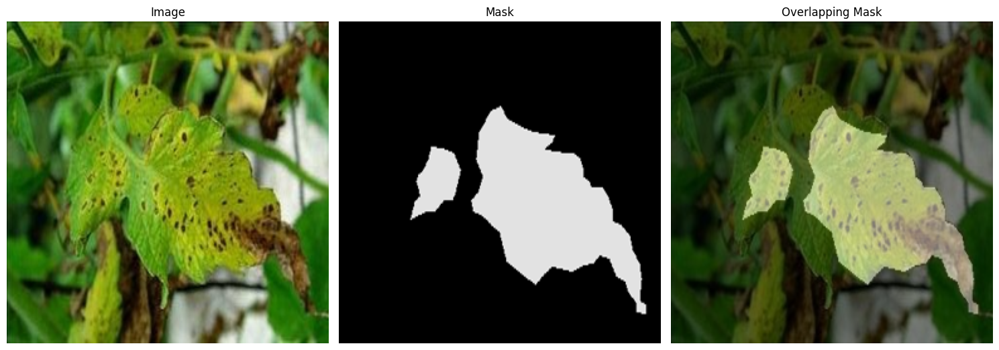

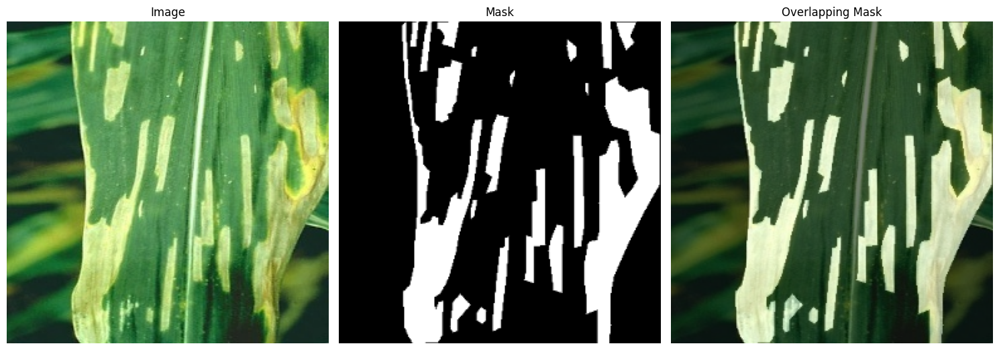

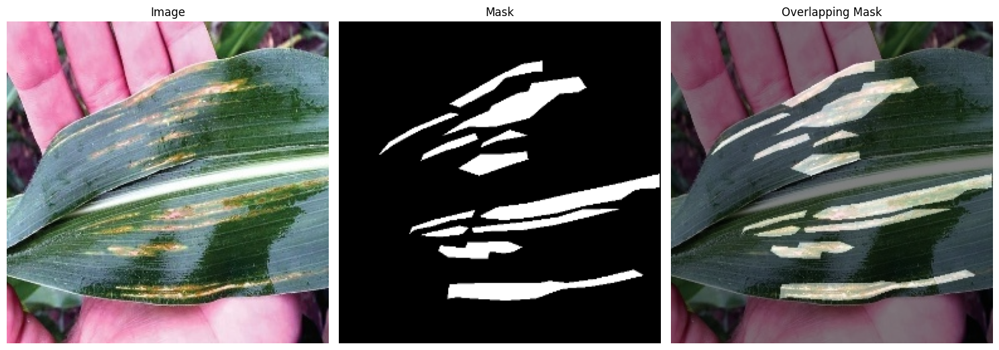

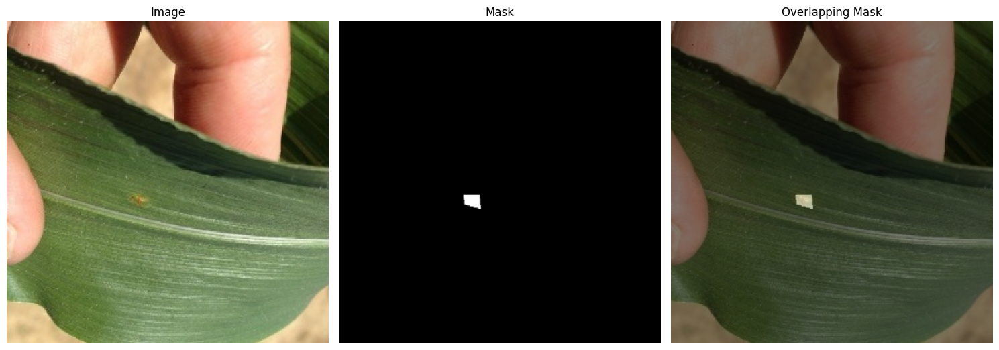

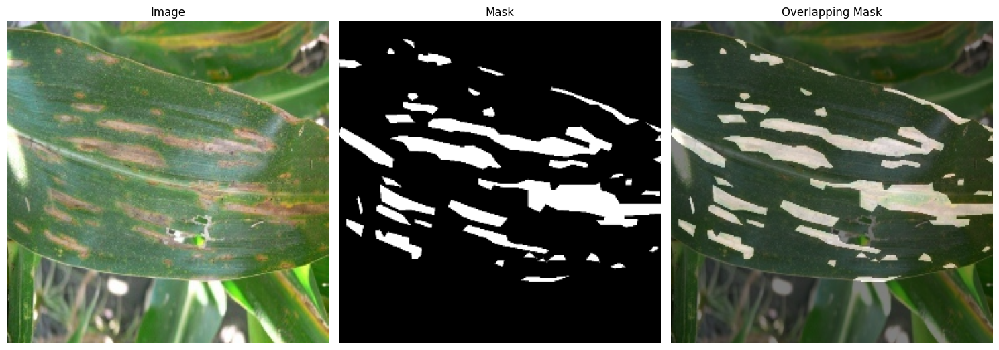

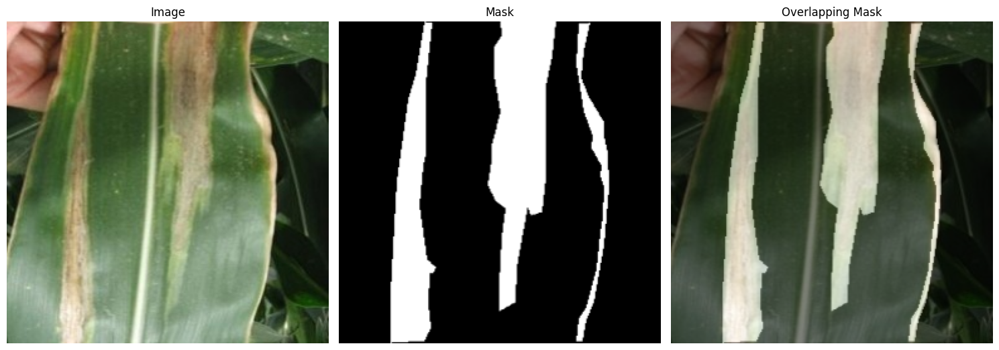

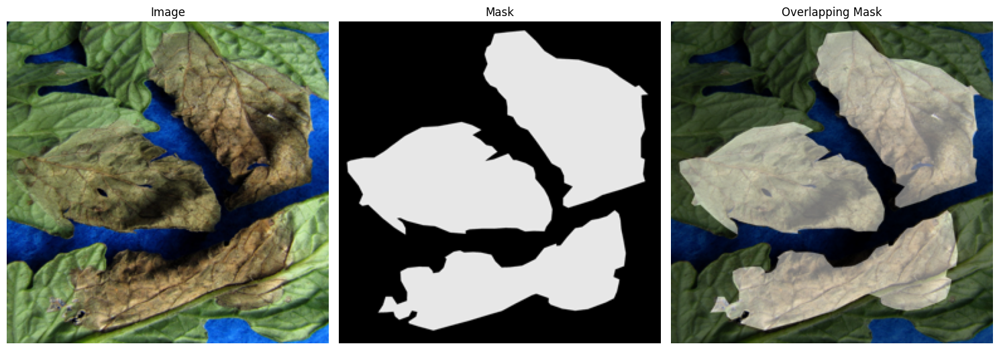

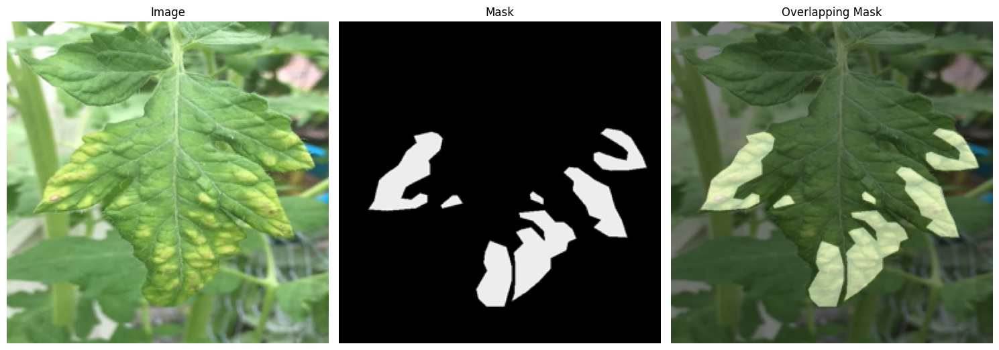

In [11]:
show_images(train_images, train_masks, n_images=8)

# **Print Shapes of Training Images and Masks**

In [12]:
print("Images shape:", np.array(train_images).shape)
print("Masks shape:", np.array(train_masks).shape)

Images shape: (2940, 256, 256, 3)
Masks shape: (2940, 256, 256, 1)


# **Define a Convolutional Block**

In [13]:
# Define a ConvBlock
class ConvBlock(tf.keras.layers.Layer):
    def __init__(self, filters:int = 256, kernel_size:int = 3, dilation_rate:int = 1, **kwargs):
        super(ConvBlock, self).__init__(**kwargs)
        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate
        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', strides=1, dilation_rate=dilation_rate, activation=None, use_bias=False),
            BatchNormalization(),
            ReLU()
        ])
    
    def call(self, X):
        return self.net(X)
    
    def get_config(self):
        base_config = super().get_config()
        return {**base_config, "filters": self.filters, "kernel_size": self.kernel_size, "dilation_rate": self.dilation_rate}


# **Atrous Spatial Pyramid Pooling**

In [14]:
# Atrous Spatial Pyramid Pooling
def AtrousSpatialPyramidPooling(X):
    _, H, W, _ = X.shape

    image_pool = AveragePooling2D(pool_size=(H, W))(X)
    image_pool = ConvBlock(filters=256, kernel_size=1)(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[1]))(image_pool)
    
    conv_1 = ConvBlock(filters=256, kernel_size=1, dilation_rate=1)(X)
    conv_6 = ConvBlock(filters=256, kernel_size=3, dilation_rate=6)(X)
    conv_12 = ConvBlock(filters=256, kernel_size=3, dilation_rate=12)(X)
    conv_18 = ConvBlock(filters=256, kernel_size=3, dilation_rate=18)(X)
    
    combined = Concatenate()([image_pool, conv_1, conv_6, conv_12, conv_18])
    output = ConvBlock(filters=256, kernel_size=1)(combined)
    
    return output



# **Define Model Parameters**

In [15]:
IMAGE_SIZE = 256
MODEL_NAME = "DeepLabV3Plus_ResNet101"

# Input Layer
inputs = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Backbone
backbone = ResNet101(input_tensor=inputs, weights='imagenet', include_top=False)

# High Level Features
DCNN = backbone.get_layer('conv4_block23_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(IMAGE_SIZE // 4 // ASPP.shape[1], IMAGE_SIZE // 4 // ASPP.shape[2]))(ASPP)

# Low Level Features
LLF = backbone.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1)(LLF)

# Combine
concat = Concatenate()([LLF, ASPP])
y = ConvBlock(filters=256, kernel_size=3)(concat)
y = ConvBlock(filters=256, kernel_size=3)(y)
y = UpSampling2D(size=(IMAGE_SIZE // y.shape[1], IMAGE_SIZE // y.shape[2]))(y)

# Output Layer
output = Conv2D(filters=1, kernel_size=3, padding='same', activation='sigmoid', use_bias=False)(y)

# Model
DeepLabV3Plus = Model(inputs, output, name=MODEL_NAME)


171446536/171446536 ━━━━━━━━━━━━━━━━━━━━ 8s 0us/step


# **Define Function to Show Model Predictions**

In [16]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tf_explain.core.grad_cam import GradCAM

def show_model_preds(images, masks, model, SIZE: tuple = (15, 8)) -> None:
    # Collect Image and Mask
    id = np.random.randint(len(images))
    image, mask = images[id], masks[id]
    
    # Make Prediction 
    pred_mask = model.predict(tf.expand_dims(image, axis=0))[0]
    
    # Squeeze the predicted mask to ensure it has the correct dimensions
    pred_mask = np.squeeze(pred_mask)
    
    # Normalize the predicted mask
    pred_mask = (pred_mask - np.min(pred_mask)) / (np.max(pred_mask) - np.min(pred_mask))
    
    # Create red overlay
    # Ensure image is in the range [0, 1] for blending
    image = image / np.max(image)
    
    # Create red overlay where only the red channel is affected
    red_overlay = np.zeros_like(image)
    red_overlay[:, :, 0] = pred_mask  # Assign predicted mask to the red channel

    # Blend image with overlay
    alpha = 0.5  # Transparency factor
    overlay_image = (1 - alpha) * image + alpha * red_overlay
    
    # Plot Size
    plt.figure(figsize=SIZE)
    
    # Plot Image
    plt.subplot(1, 5, 1)
    plt.imshow(image)
    plt.title("Input Image")
    plt.axis('off')
    
    # Plot Original Mask
    plt.subplot(1, 5, 2)
    plt.title("Expected Mask")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')
            
    # Plot Predicted Mask
    plt.subplot(1, 5, 3)
    plt.imshow(pred_mask, cmap='gray')
    plt.title("Predicted Mask")
    plt.axis('off')
    
    # Plot Overlay
    plt.subplot(1, 5, 4)
    plt.imshow(overlay_image)
    plt.title("Overlay Image")
    plt.axis('off')
    
    plt.show()


# **Define Callback to Show Progress**

In [17]:
class ShowProgress(Callback):
    
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_model_preds(test_images, test_masks, self.model)

# **Model compilation and summary**

In [18]:
# Define the custom callback if necessary
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        print(f"Epoch {epoch + 1}: {logs}")

# Compile the model
DeepLabV3Plus.compile(
    loss='binary_crossentropy',
    optimizer=tf.keras.optimizers.Adam()
)

# Summary of the model
DeepLabV3Plus.summary()

Model: "DeepLabV3Plus_ResNet101"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ InputLayer          │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ InputLayer[0][0]  │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 30,924,608 (117.97 MB)

 Trainable params: 30,839,648 (117.64 MB)

 Non-trainable params: 84,960 (331.88 KB)

# **Define model checkpoints and train the mdoel**

In [35]:
# Define the model checkpoint callback with the correct file extension
callbacks = [
    ModelCheckpoint(MODEL_NAME + ".keras", save_best_only=True),  # Use .keras extension
    ShowProgress()  # Ensure ShowProgress is defined or remove it
]

# Train the model
history = DeepLabV3Plus.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=50,
    callbacks=callbacks  # Pass the callbacks here
)


Epoch 1/50


I0000 00:00:1722217226.300602     150 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


368/368 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step - loss: 0.1202Epoch 1: {'loss': 0.0985170304775238, 'val_loss': 0.0887853130698204}
368/368 ━━━━━━━━━━━━━━━━━━━━ 242s 332ms/step - loss: 0.1202 - val_loss: 0.0888
Epoch 2/50
368/368 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - loss: 0.0888Epoch 2: {'loss': 0.08993060886859894, 'val_loss': 0.08461275696754456}
368/368 ━━━━━━━━━━━━━━━━━━━━ 61s 165ms/step - loss: 0.0888 - val_loss: 0.0846
Epoch 3/50
368/368 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - loss: 0.0905Epoch 3: {'loss': 0.08913436532020569, 'val_loss': 0.06862015277147293}
368/368 ━━━━━━━━━━━━━━━━━━━━ 61s 165ms/step - loss: 0.0905 - val_loss: 0.0686
Epoch 4/50
368/368 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step - loss: 0.0881Epoch 4: {'loss': 0.08653386682271957, 'val_loss': 0.052815310657024384}
368/368 ━━━━━━━━━━━━━━━━━━━━ 61s 167ms/step - loss: 0.0881 - val_loss: 0.0528
Epoch 5/50
368/368 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - loss: 0.0871Epoch 5: {'loss': 0.08597294241189957, 'val_loss': 0.10688792914152145}

In [21]:
model_path = '/kaggle/input/deeplabv3plus_resnet101/keras/default/1/DeepLabV3Plus_ResNet101.keras'
DeepLabV3Plus = tf.keras.models.load_model(model_path, custom_objects={'ConvBlock': ConvBlock, 'AtrousSpatialPyramidPooling': AtrousSpatialPyramidPooling})


# **Results on test dataset**

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


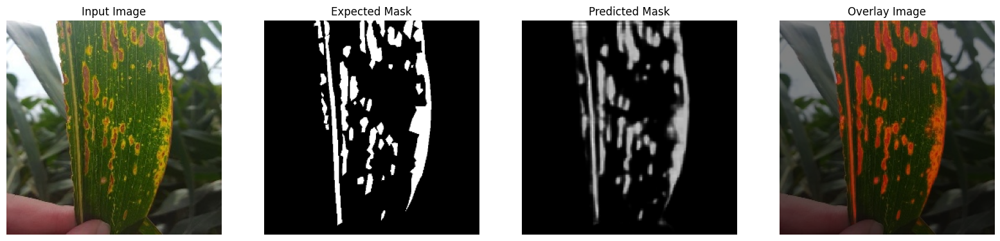

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


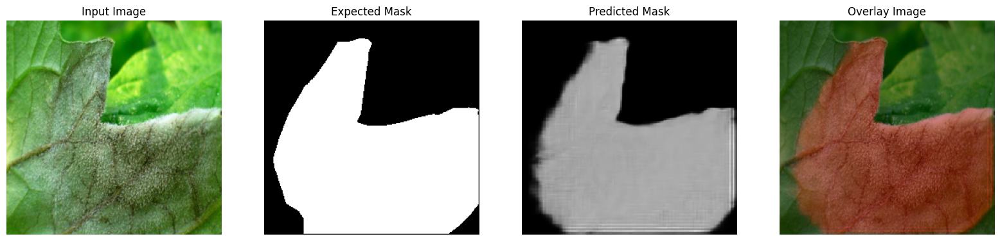

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


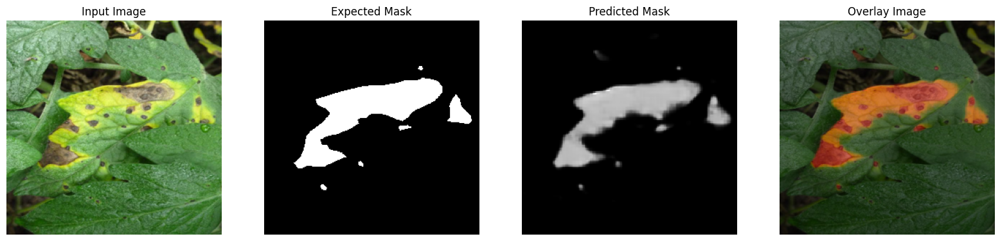

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


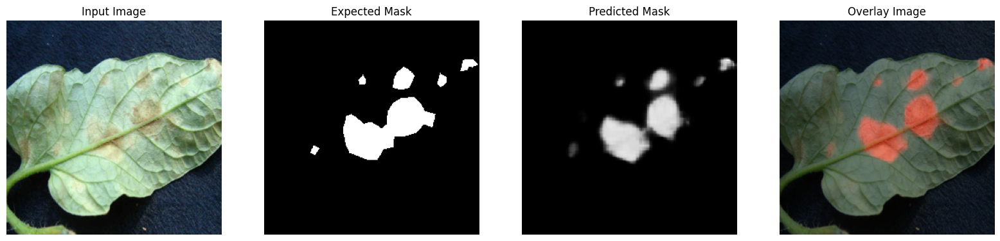

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


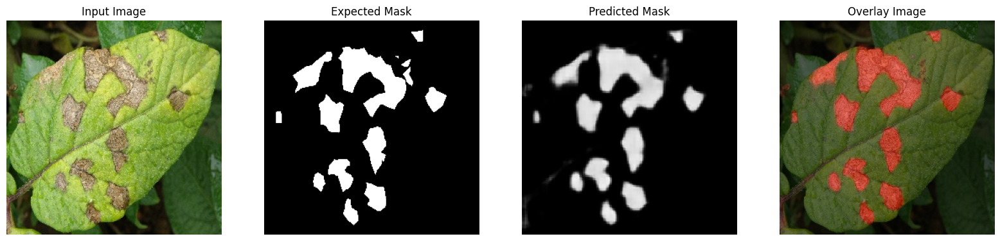

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


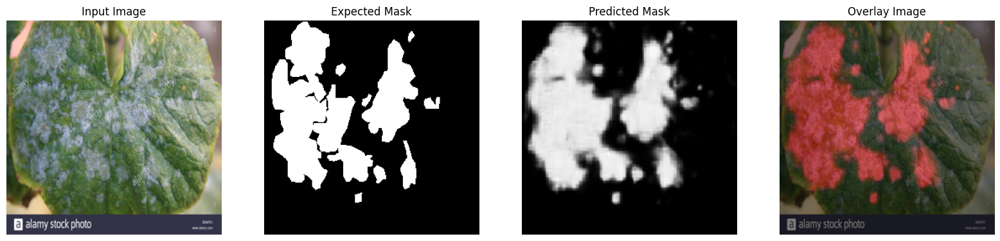

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


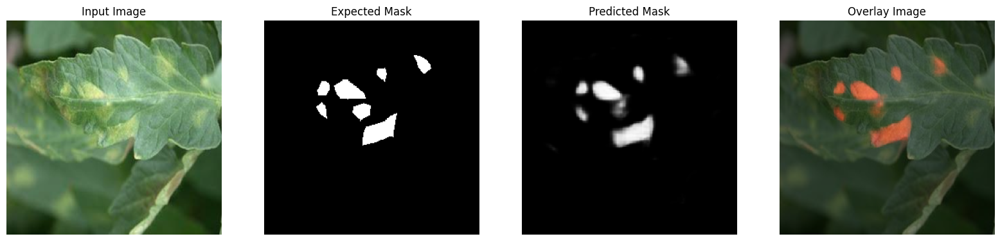

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


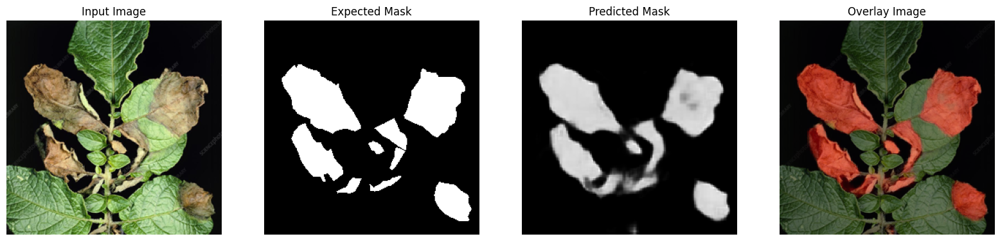

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


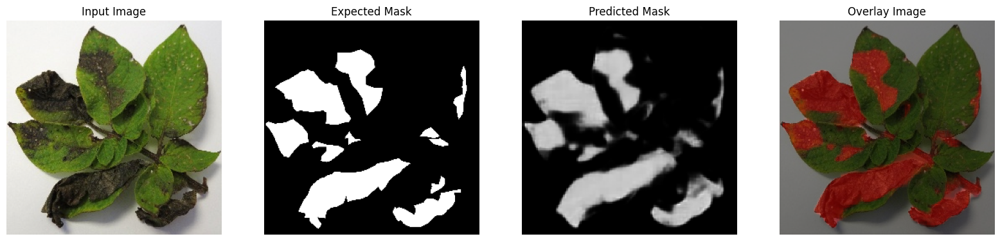

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


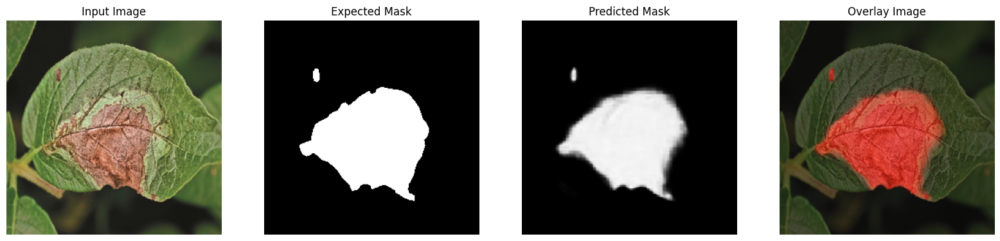

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


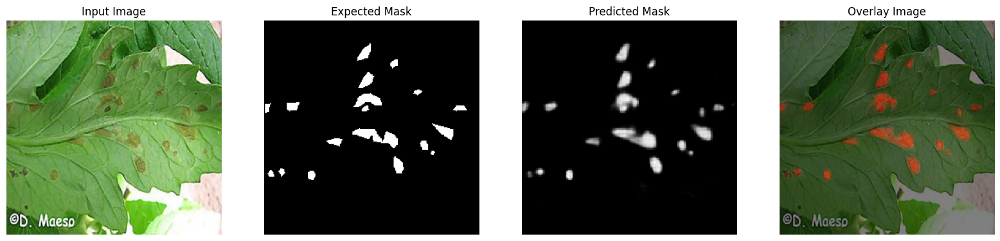

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


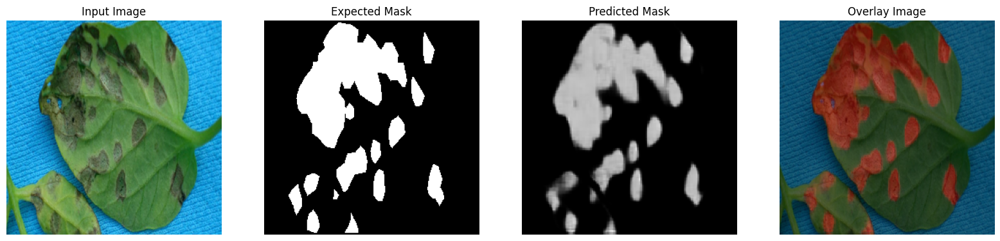

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


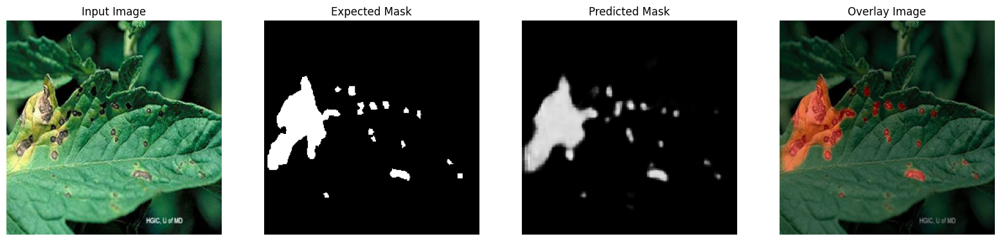

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


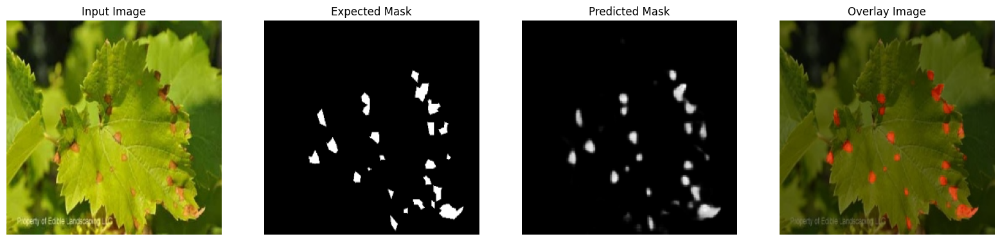

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


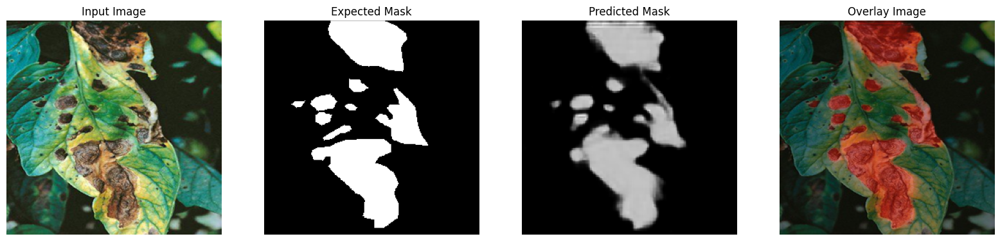

In [23]:
for i in range(15):
    show_model_preds(test_images, test_masks, model=DeepLabV3Plus, SIZE=(25,8))

# **Testing on leaf-diseases-extended Dataset**

**Loading Images**

In [51]:
directory1 = "/kaggle/input/leaf-diseases-extended/dataset/test/Potato___Late_blight"
directory2 = "/kaggle/input/leaf-diseases-extended/dataset/test/Apple___Black_rot"
directory3 = "/kaggle/input/leaf-diseases-extended/dataset/test/Coffee__rust"
directory4 = "/kaggle/input/leaf-diseases-extended/dataset/test/Corn_(maize)___Northern_Leaf_Blight"
directory5 = "/kaggle/input/leaf-diseases-extended/dataset/test/Rice_Blast"


In [52]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np
import os

# Define a function to load images manually
def load_images_from_directory(directory, image_size=(256, 256)):
    images = []
    for file_name in os.listdir(directory):
        if file_name.lower().endswith(('.bmp', '.gif', '.jpeg', '.jpg', '.png')):
            file_path = os.path.join(directory, file_name)
            image = load_img(file_path, target_size=image_size)
            image = img_to_array(image)
            images.append(image)
    return np.array(images)



In [53]:
images1 = load_images_from_directory(directory1, image_size=(IMAGE_SIZE, IMAGE_SIZE))
images2 = load_images_from_directory(directory2, image_size=(IMAGE_SIZE, IMAGE_SIZE))
images3 = load_images_from_directory(directory3, image_size=(IMAGE_SIZE, IMAGE_SIZE))
images4 = load_images_from_directory(directory4, image_size=(IMAGE_SIZE, IMAGE_SIZE))
images5 = load_images_from_directory(directory5, image_size=(IMAGE_SIZE, IMAGE_SIZE))

# **Prediction Function**

In [56]:
def show_predictionsblend(images, model, n_images=12, size=(15, 15)):
    if len(images) == 0:
        print("No images to show.")
        return
    
    plt.figure(figsize=size)
    for i in range(min(n_images, len(images))):  # Ensure we don't exceed the number of images
        idx = np.random.randint(len(images))
        image = images[idx]
        
        # Preprocess image if necessary (e.g., normalize)
        image_input = np.expand_dims(image, axis=0)  # Add batch dimension
        
        # Normalize if required (e.g., model expects [0, 1] range)
        image_input = image_input / 255.0
        
        # Predict using the model
        prediction = model.predict(image_input)
        
        # Process prediction to ensure it's in 2D
        if prediction.ndim == 4:
            prediction = prediction.squeeze(axis=0)  # Remove batch dimension
        if prediction.ndim == 3 and prediction.shape[-1] == 1:
            prediction = prediction.squeeze(axis=-1)  # Remove channel dimension if single channel
        
        # Normalize prediction if needed (e.g., to [0, 1] range)
        prediction = (prediction - prediction.min()) / (prediction.max() - prediction.min())
        
        # Prepare the overlay image (blend original image with prediction mask)
        overlay_image = np.copy(image)
        # Ensure prediction is a 2D array
        if prediction.ndim == 3:
            prediction = prediction[:, :, 0]
        
        # Convert mask to a color image
        mask_color = np.zeros_like(image)
        mask_color[prediction > 0.5] = [255, 0, 0]  # Red mask
        
        # Blend original image with mask
        blended_image = np.clip(image + mask_color, 0, 255).astype(np.uint8)

        # Plot images
        plt.subplot(n_images, 3, 3*i+1)
        plt.imshow(image.astype("uint8"))
        plt.title("Input Image")
        plt.axis('off')
        
        plt.subplot(n_images, 3, 3*i+2)
        plt.imshow(prediction, cmap='gray')  # Use 'gray' colormap for single channel predictions
        plt.title("Model Prediction")
        plt.axis('off')
        
        plt.subplot(n_images, 3, 3*i+3)
        plt.imshow(blended_image.astype("uint8"))
        plt.title("Overlay")
        plt.axis('off')
        
    plt.tight_layout()
    plt.show()


# **Results**

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


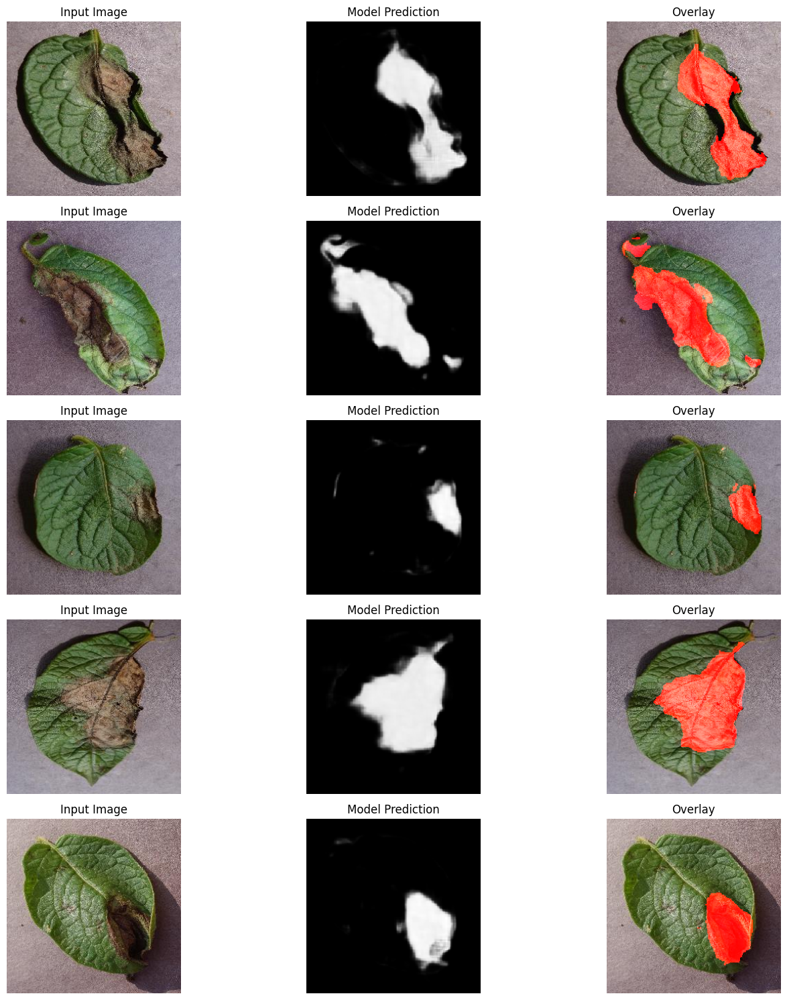

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


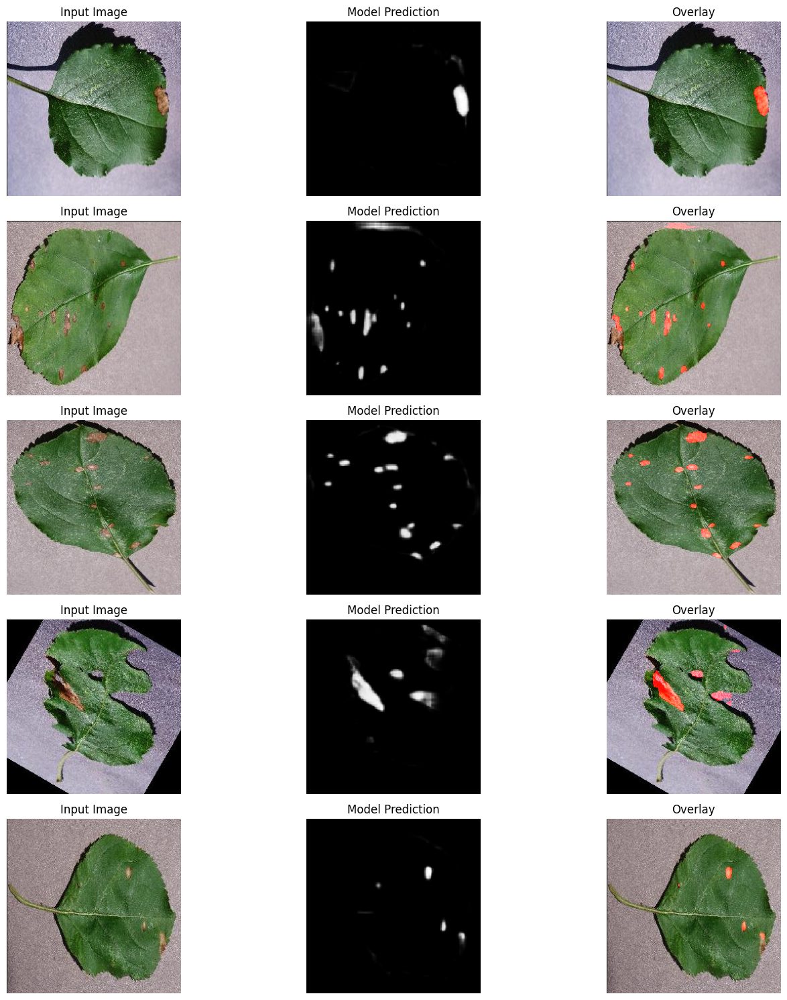

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


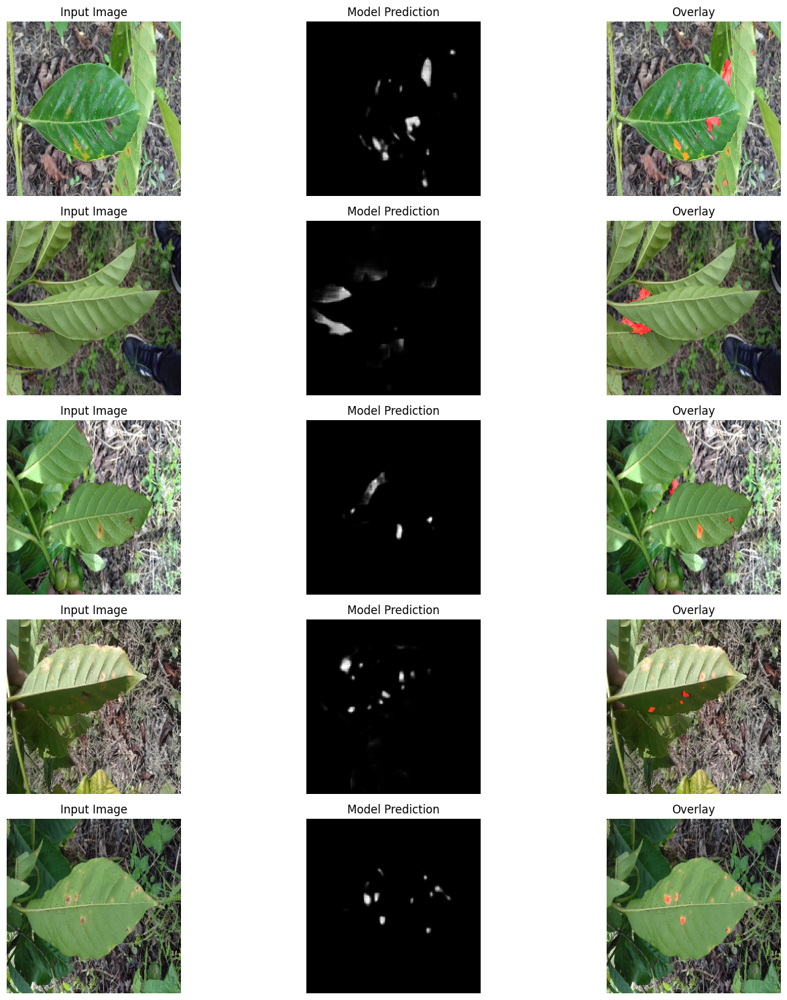

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


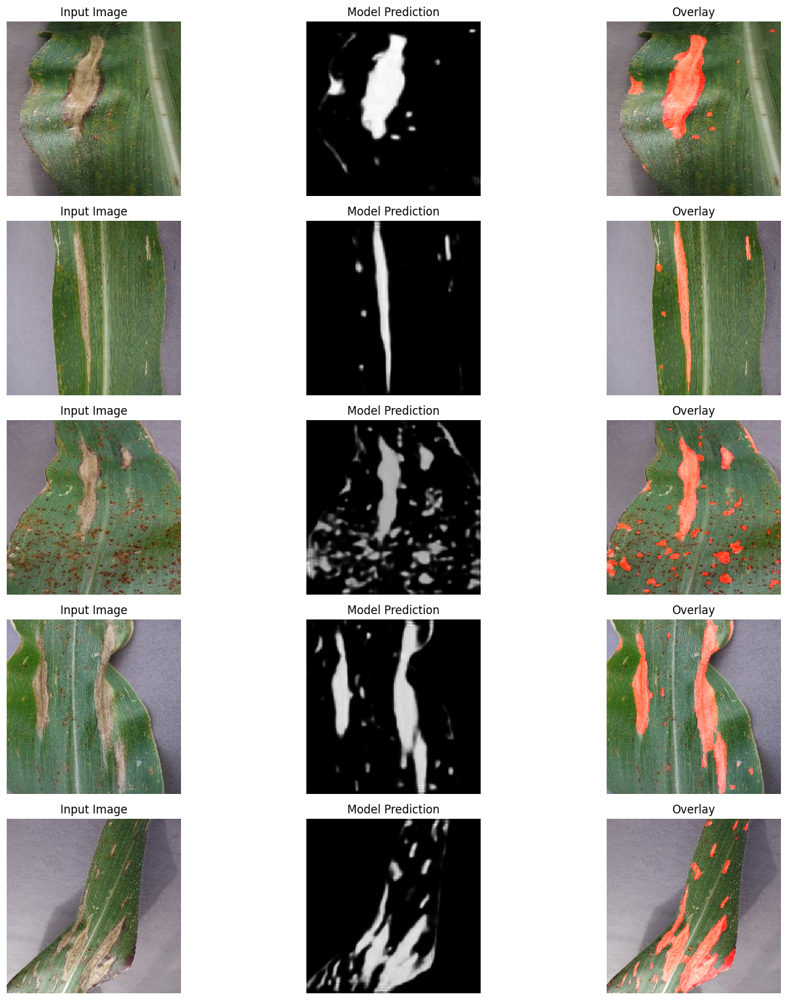

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


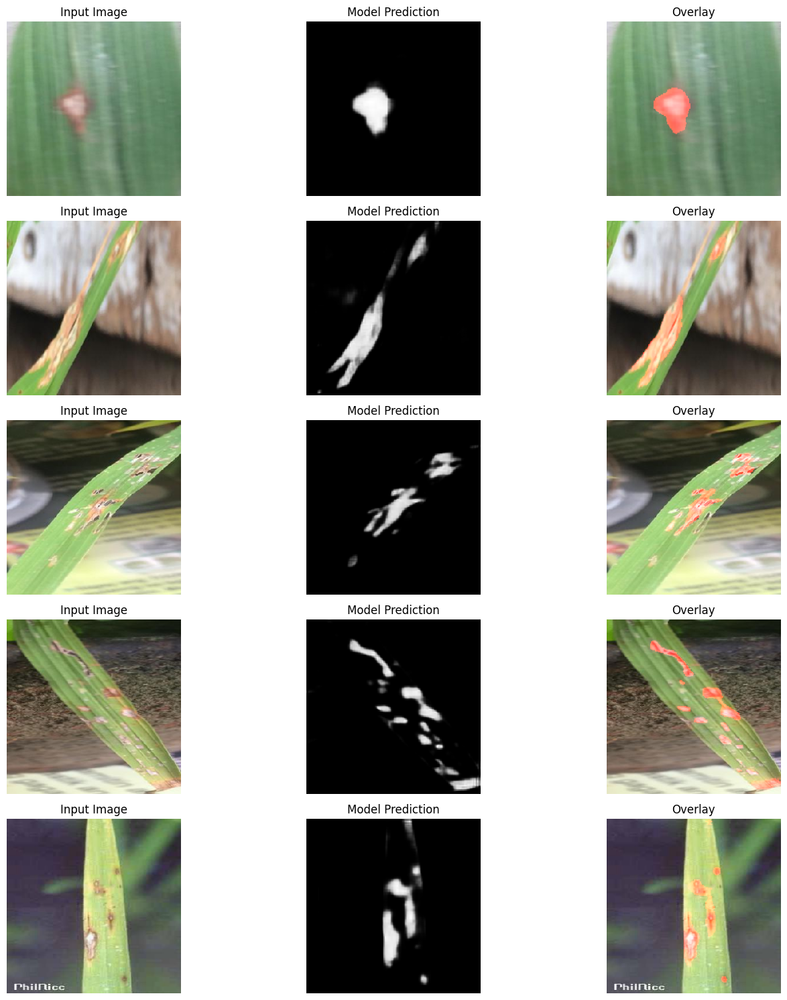

In [57]:
show_predictionsblend(images1, DeepLabV3Plus, n_images=5, size=(15, 15))
show_predictionsblend(images2, DeepLabV3Plus, n_images=5, size=(15, 15))
show_predictionsblend(images3, DeepLabV3Plus, n_images=5, size=(15, 15))
show_predictionsblend(images4, DeepLabV3Plus, n_images=5, size=(15, 15))
show_predictionsblend(images5, DeepLabV3Plus, n_images=5, size=(15, 15))